## Setting Libraries

*ffmpeg 다운로드 필요*

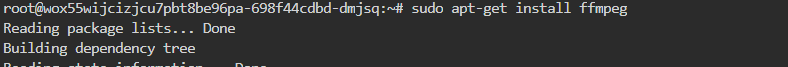

In [1]:
# !pip install pydub
# !pip install pytube
# !pip install subprocess

In [2]:
import os
import subprocess
from pytube import YouTube
from pytube.exceptions import VideoUnavailable
from pydub import AudioSegment
from IPython import display as ipd

In [3]:
import json

class YoutubeDownloader():
    def __init__(self, folder):
        self.folder = folder
        
    def down_files(self, urls):
        if type(urls) == list and len(urls):
            for idx, url in enumerate(urls):
                try:
                    yt = YouTube(url)
                except VideoUnavailable:
                    print(f'{idx + 1}번째 {url}는 사용할 수 없습니다.')
                else:
                    audio = yt.streams.filter(only_audio=True).first()
                    print(f'파일명: {yt.title}\n')
                    print(f'다운로드 시작')
                    try:
                        filename = input("원하는 파일명.mp4를 입력하세요. ")
                        audio.download(output_path=self.folder, filename=filename)
                        print(f'다운로드 완료 {(idx + 1)} / {len(urls)}')
                        print("-" * 100)
                    except Exception:
                        print(f"다운로드 중 오류가 발생하였습니다.")
                        continue
            print("파일 다운로드 종료")
            return
        
        else:
            print('URL을 올바르게 입력해주세요')
            return

In [4]:
# 파일을 저장할 디렉토리 경로 설정
folder = os.path.join(os.getcwd(), 'yt_output')

In [5]:
# 가져올 Youtube 영상 url을 urls 배열에 저장  
urls = ['https://youtu.be/LZh4ioW31J8',
       'https://youtu.be/WAKjzzAAYRo',
       'https://youtu.be/-FClALfxlBk',
       'https://youtu.be/psUQ3NlTb_4']

In [6]:
# YoutubeDownloader 객체 생성
yt = YoutubeDownloader(folder)

In [7]:
# urls 배열을 받아 다운로드 진행
yt.down_files(urls)

파일명: ASMR 99.99% of You Will SLEEP 😴💤 ASMR학과 수면학개론 제 1강

다운로드 시작
원하는 파일명.mp4를 입력하세요. asmr_1.mp4
다운로드 완료 1 / 4
----------------------------------------------------------------------------------------------------
파일명: ASMR Guaranteed Tingles 🤤 99.9% of You Will Sleep / 3Hr (No Talking)

다운로드 시작
원하는 파일명.mp4를 입력하세요. asmr_2.mp4
다운로드 완료 2 / 4
----------------------------------------------------------------------------------------------------
파일명: ASMR 이거 진짜 귀파는거 같네👂귀청소 (노토킹)

다운로드 시작
원하는 파일명.mp4를 입력하세요. asmr_3.mp4
다운로드 완료 3 / 4
----------------------------------------------------------------------------------------------------
파일명: 지읒asmr} 내 취향 단어 찾기 (62가지 단어반복)

다운로드 시작
원하는 파일명.mp4를 입력하세요. asmr_4.mp4
다운로드 완료 4 / 4
----------------------------------------------------------------------------------------------------
파일 다운로드 종료


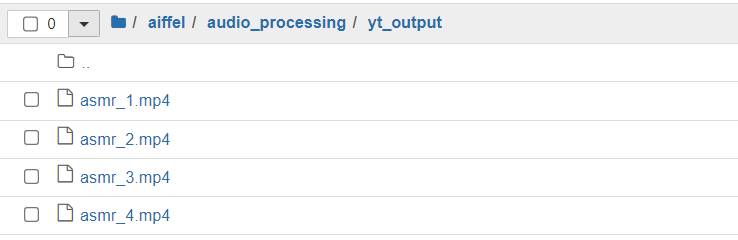

In [8]:
from datetime import datetime
import json

class AudioHandler():
    def __init__(self, folder, filename):
        self.folder = folder
        self.filename = filename
        self.filepath = folder + '/' + filename
        self.info = {}
        self.__audio = AudioSegment.from_file(self.filepath)
    
    def set_info(self, url, genre, channel, comment=None):
        self.info['url'] = url
        self.info['genre'] = genre
        self.info['channel'] = channel
        self.info['file_format'] = self.filename.split('.')[-1]
        self.info['date'] = datetime.now().strftime('%Y-%m%d %H:%M:%S')
        self.info['comment'] = comment
    
    def get_info(self):
        return self.info
    
    def get_duration(self):
        return self.__audio.duration_seconds
    
    def file_split(self, start_min, start_sec, end_min, end_sec, file_name, file_format, folder=None):
        t1 = start_min * 60 * 1000 + start_sec * 1000
        t2 = end_min * 60 * 1000 + end_sec * 1000
        split_audio = self.__audio[t1:t2]
        if folder:
            split_audio.export(folder + '/' + file_name + '.' + file_format, format=file_format)
        else:
            split_audio.export(self.folder + '/' + file_name + '.' + file_format, format=file_format)
            
    def convert_format(self, file_format, filename=None):
        if filename:
            self.__audio.export(filename + "." + file_format, format=file_format)
        else:
            self.__audio.export(self.filename + "." + file_format, format=file_format)
            
    def dict2json(self):
        return json.dumps(self.info, ensure_ascii = False)

In [9]:
# AudioHandler 객체 생성
# 파일의 경로와 파일명을 받아 오디오(ad) 객체 생성
ad = AudioHandler(folder, 'asmr_1.mp4')

In [10]:
# 파일의 정보를 설정
ad.set_info('https://youtu.be/LZh4ioW31J8', '혼종', 'Vito ASMR')

In [11]:
# 파일정보
ad.get_info()

{'url': 'https://youtu.be/LZh4ioW31J8',
 'genre': '혼종',
 'channel': 'Vito ASMR',
 'file_format': 'mp4',
 'date': '2021-1002 06:53:05',
 'comment': None}

In [12]:
# 파일의 총 재생시간
ad.get_duration()

13894.356462585034

In [13]:
# 원본 파일에서 0분 30초 ~ 1분 30초 구간을 현재 폴더에 '귀청소_1.wav' 라는 파일명으로 저장
ad.file_split(0,30,1,30,'asmr_1','wav')

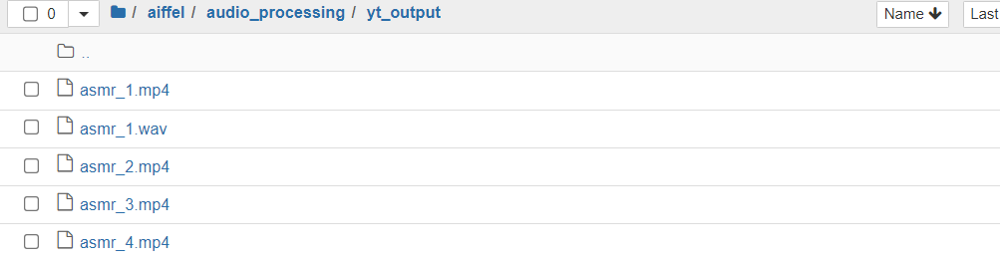

In [14]:
ipd.Audio(folder + '/asmr_1.wav', rate=16000)

In [15]:
# 원본 파일에서 1분 30초 ~ 2분 30초 구간을 새로운 폴더에 'asmr_2.wav' 라는 파일명으로 저장
new_path = os.path.join(os.getcwd(), 'audio_output')
ad.file_split(1,30,2,30,'asmr_2','wav', new_path)

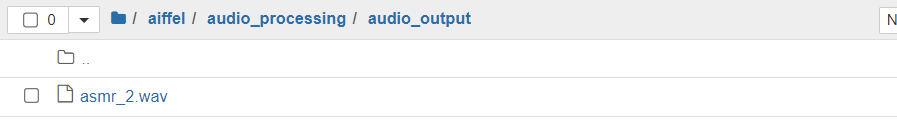

In [16]:
ipd.Audio(new_path +'/asmr_2.wav', rate=16000)

In [17]:
# 파일의 정보를 json으로 변환 후 반환
ad.dict2json()

'{"url": "https://youtu.be/LZh4ioW31J8", "genre": "혼종", "channel": "Vito ASMR", "file_format": "mp4", "date": "2021-1002 06:53:05", "comment": null}'

### References

#### pydub : https://pytube.io/en/latest/index.html
#### Pydub : https://github.com/jiaaro/pydub
#### ffmpeg : https://github.com/FFmpeg/FFmpeg